## Week 5 Final Project - Find the best location to open a new Caffehouse in Sydney

#### Before we get the data and start exploring it, let's download all the dependencies that we will need.

In [1]:
!pip install geocoder

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

!conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
import geocoder # to get coordinates
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library

print('Libraries imported.')

Solving environment: ...working... done

# All requested packages already installed.

Solving environment: ...working... done

# All requested packages already installed.

Libraries imported.


##### First we need to get the dataset of all suburbs in sydney with postcodes.This can be done using web scraping 

In [3]:
url='https://www.intosydneydirectory.com.au/sydney-postcodes.php'
df_list= pd.read_html(url)

In [4]:
df_list[1].head() #2st list of the webiste is for project purpose

,0,1,2
0,Abbotsbury,NSW,2176
1,Abbotsford,NSW,2046
2,Agnes Banks,NSW,2753
3,Airds,NSW,2560
4,Alexandria,NSW,2015


##### Define a new dataframe that includes the dataset of sydney suburbs with postcode

In [5]:
sydney_data=df_list[1]

In [6]:
sydney_data.rename(columns={0:'Neighborhood',1:'State',2:'Postcode'},inplace=True)
print(sydney_data.shape)
sydney_data.head(5)

(689, 3)


,Neighborhood,State,Postcode
0,Abbotsbury,NSW,2176
1,Abbotsford,NSW,2046
2,Agnes Banks,NSW,2753
3,Airds,NSW,2560
4,Alexandria,NSW,2015


#### Here State column is not of interest so that column can be dropped.

In [7]:
sydney_data.drop(['State'], axis=1,inplace=True)


In [8]:
sydney_data.head(5)

,Neighborhood,Postcode
0,Abbotsbury,2176
1,Abbotsford,2046
2,Agnes Banks,2753
3,Airds,2560
4,Alexandria,2015


In [9]:
print(sydney_data.shape)
type(sydney_data)

(689, 2)


pandas.core.frame.DataFrame

In [10]:
# define a function to get coordinates
def get_latlng(neighborhood):
    # initialize your variable to None
    lat_lng_coords = None
    # loop until you get the coordinates
    while(lat_lng_coords is None):
        g = geocoder.arcgis('{}, Sydney, Australia'.format(neighborhood))
        lat_lng_coords = g.latlng
    return lat_lng_coords

In [11]:
# call the function to get the coordinates, store in a new list using list comprehension
coords = [ get_latlng(neighborhood) for neighborhood in sydney_data["Neighborhood"].tolist() ]

In [12]:
coords

[[-33.87284999999997, 150.8672100000001],
 [-33.850409999999954, 151.12846000000002],
 [-33.61444999999998, 150.7108300000001],
 [-34.08446999999995, 150.82904000000008],
 [-33.91236999999995, 151.19703000000004],
 [-33.99347999999998, 151.02471000000003],
 [-33.76560999999998, 151.25159000000008],
 [-33.97025999999994, 151.1160000000001],
 [-34.08386999999993, 150.80243000000007],
 [-33.88004999999998, 151.1713000000001],
 [-33.68130955409571, 150.97981582564793],
 [-34.08473963708334, 150.806658540858],
 [-33.88252243196826, 151.00448659162362],
 [-33.93664999999993, 151.14679],
 [-33.78836999999993, 150.87983000000008],
 [-33.80813999999998, 151.18380000000002],
 [-33.898169999999936, 151.1210000000001],
 [-33.916049999999984, 150.90111000000002],
 [-33.88919999999996, 151.12543000000005],
 [-33.68870999999996, 151.1094700000001],
 [-33.84847999999994, 151.02951000000007],
 [-33.897596293986226, 151.15457075339873],
 [-33.92683509099993, 150.80831086900002],
 [-33.63585999999998, 15

In [13]:
# create temporary dataframe to populate the coordinates into Latitude and Longitude
sydney_coords = pd.DataFrame(coords, columns=['Latitude', 'Longitude'])

In [14]:
sydney_coords.head()

,Latitude,Longitude
0,-33.87285,150.86721
1,-33.85041,151.12846
2,-33.61445,150.71083
3,-34.08447,150.82904
4,-33.91237,151.19703


In [15]:
# merge the coordinates into the original dataframe
sydney_data['Latitude'] = sydney_coords['Latitude']
sydney_data['Longitude'] = sydney_coords['Longitude']

In [16]:
# check the neighborhoods and the coordinates
print(sydney_data.shape)
sydney_data.head(14)

(689, 4)


,Neighborhood,Postcode,Latitude,Longitude
0,Abbotsbury,2176,-33.872850,150.867210
1,Abbotsford,2046,-33.850410,151.128460
2,Agnes Banks,2753,-33.614450,150.710830
3,Airds,2560,-34.084470,150.829040
4,Alexandria,2015,-33.912370,151.197030
5,Alfords Point,2234,-33.993480,151.024710
6,Allambie Heights,2100,-33.765610,151.251590
7,Allawah,2218,-33.970260,151.116000
8,Ambarvale,2560,-34.083870,150.802430
9,Annandale,2038,-33.880050,151.171300


In [17]:
sydney_data.dropna(inplace=True)

In [18]:
sydney_data.shape

(689, 4)

## Use geopy library to get the latitude and longitude values of Sydney.

In [19]:

address = 'Sydney, Australia'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of Sydney are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Sydney are -33.8548157, 151.2164539.


### Generate map of Sydney using latitude and longitude values to visualize the neighborhoods 

In [20]:

map_sydney   = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood in zip(sydney_data['Latitude'], sydney_data['Longitude'], sydney_data['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_sydney)  
    
map_sydney

# Explore Sydney neighborhood  with Foursquare API

# FourSquare Credentials

In [21]:
CLIENT_ID = 'JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC'
CLIENT_SECRET = 'DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG'
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC
CLIENT_SECRET:DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG


### Let's explore the first neighborhood in our dataframe.
###### Get the neighborhood's name.

In [22]:
sydney_data.loc[0, 'Neighborhood']

'Abbotsbury'

#### Get the neighborhood's latitude and longitude values.

In [23]:
neighborhood_latitude = sydney_data.loc[0, 'Latitude'] # neighborhood latitude value
neighborhood_longitude = sydney_data.loc[0, 'Longitude'] # neighborhood longitude value

neighborhood_name = sydney_data.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Abbotsbury are -33.87284999999997, 150.8672100000001.


### Now, let's get the top 10 venues that are in Abbotsbury within a radius of 500 meters.

#### First, let's create the GET request URL.

In [24]:
LIMIT=10
radius=500

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
url



'https://api.foursquare.com/v2/venues/explore?&client_id=JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC&client_secret=DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG&v=20180605&ll=-33.87284999999997,150.8672100000001&radius=500&limit=10'

### Send the GET request and examine the resutls

In [25]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f1d1537fcc0f268b5743d68'},
 'response': {'headerLocation': 'Current map view',
  'headerFullLocation': 'Current map view',
  'headerLocationGranularity': 'unknown',
  'totalResults': 4,
  'suggestedBounds': {'ne': {'lat': -33.86834999549997,
    'lng': 150.87261976718878},
   'sw': {'lat': -33.877350004499974, 'lng': 150.86180023281145}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b84b81af964a5202f4231e3',
       'name': 'Stockdale Reserve',
       'location': {'lat': -33.871098,
        'lng': 150.86806,
        'labeledLatLngs': [{'label': 'display',
          'lat': -33.871098,
          'lng': 150.86806}],
        'distance': 210,
        'postalCode': '2176',
        'cc': 'AU',
        'state': 'New South Wales',
        

In [26]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [27]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

C:\Users\sapna\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  This is separate from the ipykernel package so we can avoid doing imports until


,name,categories,lat,lng
0,Stockdale Reserve,Park,-33.871098,150.868060
1,Abbotsbury Shops,Convenience Store,-33.869554,150.865294
2,817 bus stop,Bus Stop,-33.869773,150.870122
3,Foodworks,Supermarket,-33.869191,150.865388


In [28]:
nearby_venues

,name,categories,lat,lng
0,Stockdale Reserve,Park,-33.871098,150.868060
1,Abbotsbury Shops,Convenience Store,-33.869554,150.865294
2,817 bus stop,Bus Stop,-33.869773,150.870122
3,Foodworks,Supermarket,-33.869191,150.865388


In [29]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

4 venues were returned by Foursquare.


In [30]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            100)
             # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
        nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    print('Found {} venues in {} neighborhoods.'.format(nearby_venues.shape[0], len(venues_list)))
    
    return(nearby_venues)
            
        
 

In [31]:
#to get the total number of venues available in sydney
sydney_venues = getNearbyVenues(names=sydney_data['Neighborhood'],
                                   latitudes=sydney_data['Latitude'],
                                   longitudes=sydney_data['Longitude']
                                  )

Found 8827 venues in 689 neighborhoods.


In [32]:
print(sydney_venues.shape)
sydney_venues.head(20)

(8827, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbotsbury,-33.87285,150.86721,Stockdale Reserve,-33.871098,150.868060,Park
1,Abbotsbury,-33.87285,150.86721,Abbotsbury Shops,-33.869554,150.865294,Convenience Store
2,Abbotsbury,-33.87285,150.86721,817 bus stop,-33.869773,150.870122,Bus Stop
3,Abbotsbury,-33.87285,150.86721,Foodworks,-33.869191,150.865388,Supermarket
4,Abbotsford,-33.85041,151.12846,The Cove Dining Co,-33.850933,151.129015,Café
5,Abbotsford,-33.85041,151.12846,The Cove Dining Co,-33.850950,151.129110,Café
6,Abbotsford,-33.85041,151.12846,"Greenwest Pools, Spas & Landscapes",-33.850600,151.127605,Construction & Landscaping
7,Abbotsford,-33.85041,151.12846,Henry Lawson Park,-33.850350,151.125895,Park
8,Abbotsford,-33.85041,151.12846,Sistina Ristorante & Pizzeria,-33.848149,151.128307,Pizza Place
9,Abbotsford,-33.85041,151.12846,Lock Stock And Bottle,-33.847860,151.127970,Wine Shop


###### There are total 8827 venues in 689 venues.

In [33]:
sydney_venues

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbotsbury,-33.872850,150.867210,Stockdale Reserve,-33.871098,150.868060,Park
1,Abbotsbury,-33.872850,150.867210,Abbotsbury Shops,-33.869554,150.865294,Convenience Store
2,Abbotsbury,-33.872850,150.867210,817 bus stop,-33.869773,150.870122,Bus Stop
3,Abbotsbury,-33.872850,150.867210,Foodworks,-33.869191,150.865388,Supermarket
4,Abbotsford,-33.850410,151.128460,The Cove Dining Co,-33.850933,151.129015,Café
5,Abbotsford,-33.850410,151.128460,The Cove Dining Co,-33.850950,151.129110,Café
6,Abbotsford,-33.850410,151.128460,"Greenwest Pools, Spas & Landscapes",-33.850600,151.127605,Construction & Landscaping
7,Abbotsford,-33.850410,151.128460,Henry Lawson Park,-33.850350,151.125895,Park
8,Abbotsford,-33.850410,151.128460,Sistina Ristorante & Pizzeria,-33.848149,151.128307,Pizza Place
9,Abbotsford,-33.850410,151.128460,Lock Stock And Bottle,-33.847860,151.127970,Wine Shop


### Let's check how many venues were returned for each neighborhood

In [34]:
sydney_venues.groupby('Neighborhood').count()


,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbotsbury,4,4,4,4,4,4
Abbotsford,7,7,7,7,7,7
Airds,4,4,4,4,4,4
Alexandria,31,31,31,31,31,31
Alfords Point,5,5,5,5,5,5
Allambie Heights,5,5,5,5,5,5
Allawah,4,4,4,4,4,4
Ambarvale,7,7,7,7,7,7
Annandale,25,25,25,25,25,25


#### Let's find out how many unique categories can be curated from all the returned venues

In [35]:
print('There are {} uniques categories.'.format(len(sydney_venues['Venue Category'].unique())))

There are 376 uniques categories.


# Analyze Each Neighborhood

In [36]:
#one hot encoding
sydney_onehot = pd.get_dummies(sydney_venues[['Venue Category']], prefix="", prefix_sep="")

#add neighborhood column back to dataframe
sydney_onehot['Neighborhood'] = sydney_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [sydney_onehot.columns[-1]] + list(sydney_onehot.columns[:-1])
sydney_onehot = sydney_onehot[fixed_columns]

sydney_onehot.head()

,Yoga Studio,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,American Restaurant,Aquarium,Arcade,Arepa Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bathing Area,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Beijing Restaurant,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boat Rental,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Bowling Green,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cambodian Restaurant,Campground,Candy Store,Cantonese Restaurant,Car Wash,Cha Chaan Teng,Chaat Place,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Rec Center,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dog Run,Donut Shop,Drugstore,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Entertainment Service,Event Space,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,Forest,Fountain,Frame Store,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Government Building,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indonesian Meatball Place,Indonesian Restaurant,Indoor Play Area,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Modern Greek Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Motorsports Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Neighborhood,Newsstand,Night Market,Nightclub,Non-Profit,Noodle House,Office,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Store,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Planetarium,Platform,Playgrou

### And let's examine the new dataframe size.

In [37]:
sydney_onehot.shape

(8827, 376)

##### Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [38]:
sydney_grouped = sydney_onehot.groupby('Neighborhood').mean().reset_index()
sydney_grouped

,Neighborhood,Yoga Studio,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,American Restaurant,Aquarium,Arcade,Arepa Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bathing Area,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Beijing Restaurant,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boat Rental,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Bowling Green,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cambodian Restaurant,Campground,Candy Store,Cantonese Restaurant,Car Wash,Cha Chaan Teng,Chaat Place,Cheese Shop,Child Care Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Rec Center,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Coworking Space,Creperie,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dog Run,Donut Shop,Drugstore,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Entertainment Service,Event Space,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,Forest,Fountain,Frame Store,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Government Building,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indonesian Meatball Place,Indonesian Restaurant,Indoor Play Area,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Modern Greek Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Motorsports Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Newsstand,Night Market,Nightclub,Non-Profit,Noodle House,Office,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Store,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Planetarium,Platform,Playgrou

##### Let's confirm the new size

In [39]:
sydney_grouped.shape

(624, 376)

## Let's print each neighborhood along with the top 5 most common venues

In [40]:
num_top_venues = 5

for hood in sydney_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = sydney_grouped[sydney_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abbotsbury----
               venue  freq
0  Convenience Store  0.25
1               Park  0.25
2        Supermarket  0.25
3           Bus Stop  0.25
4             Office  0.00


----Abbotsford----
                        venue  freq
0                        Café  0.29
1  Construction & Landscaping  0.14
2                   Wine Shop  0.14
3                        Park  0.14
4             Thai Restaurant  0.14


----Airds----
           venue  freq
0            Pub  0.25
1    Gas Station  0.25
2  Shopping Mall  0.25
3    Candy Store  0.25
4    Music Venue  0.00


----Alexandria----
                venue  freq
0                Café  0.23
1   Electronics Store  0.06
2  Italian Restaurant  0.03
3  Basketball Stadium  0.03
4     Thai Restaurant  0.03


----Alfords Point----
           venue  freq
0    Candy Store   0.2
1   Burger Joint   0.2
2     Playground   0.2
3  Shopping Mall   0.2
4    Flea Market   0.2


----Allambie Heights----
           venue  freq
0           Café   0.4
1   

                   venue  freq
0      Convenience Store   0.5
1                    Bar   0.5
2                 Office   0.0
3           Outlet Store   0.0
4  Outdoors & Recreation   0.0


----Bilgola----
                   venue  freq
0         Scenic Lookout  0.33
1                    Spa  0.33
2                   Café  0.33
3           Noodle House  0.00
4  Outdoors & Recreation  0.00


----Birchgrove----
            venue  freq
0             Pub  0.38
1            Café  0.25
2            Park  0.12
3  Cricket Ground  0.12
4    Tennis Court  0.12


----Birrong----
           venue  freq
0  Bowling Green  0.25
1  Grocery Store  0.25
2     Playground  0.25
3  Train Station  0.25
4    Yoga Studio  0.00


----Blackett----
                   venue  freq
0                 Market   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Blacktown----
                  venue  freq
0  Fast Food Restaurant  0.13
1   

                venue  freq
0                Café  0.13
1         Coffee Shop  0.07
2         Supermarket  0.07
3  Falafel Restaurant  0.07
4     Thai Restaurant  0.07


----Chifley----
                venue  freq
0                Café  0.25
1  Chinese Restaurant  0.25
2         Bus Station  0.25
3          Restaurant  0.25
4         Yoga Studio  0.00


----Chippendale----
          venue  freq
0          Café  0.19
1           Bar  0.11
2           Pub  0.06
3  Burger Joint  0.05
4   Coffee Shop  0.05


----Chipping Norton----
                venue  freq
0  Italian Restaurant  0.25
1         Supermarket  0.25
2       Shopping Mall  0.25
3         Coffee Shop  0.25
4         Yoga Studio  0.00


----Chiswick----
             venue  freq
0  Harbor / Marina  0.25
1             Café  0.25
2     Dance Studio  0.25
3     Soccer Field  0.25
4      Yoga Studio  0.00


----Chullora----
              venue  freq
0               Bar   0.2
1              Café   0.2
2     Jewelry Store   0.2
3  Bus

                   venue  freq
0                   Café  0.19
1                  Hotel  0.07
2  Australian Restaurant  0.05
3     Italian Restaurant  0.05
4                    Bar  0.03


----Elvina Bay----
             venue  freq
0  Harbor / Marina  0.75
1            Hotel  0.25
2      Yoga Studio  0.00
3     Noodle House  0.00
4     Outlet Store  0.00


----Emerton----
                     venue  freq
0     Fast Food Restaurant   0.2
1            Shopping Mall   0.2
2                 Gym Pool   0.1
3  Fruit & Vegetable Store   0.1
4            Grocery Store   0.1


----Emu Heights----
                   venue  freq
0                   Café   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Emu Plains----
         venue  freq
0  Supermarket  0.33
1          Bar  0.17
2         Café  0.17
3        Field  0.17
4  Pizza Place  0.17


----Enfield----
               venue  freq
0    Thai Restaurant  0.13


                venue  freq
0                Café  0.50
1  Italian Restaurant  0.25
2      Breakfast Spot  0.25
3         Yoga Studio  0.00
4              Office  0.00


----Huntingwood----
                   venue  freq
0             Donut Shop   1.0
1            Yoga Studio   0.0
2   Pakistani Restaurant   0.0
3           Outlet Store   0.0
4  Outdoors & Recreation   0.0


----Huntleys Cove----
            venue  freq
0            Park  0.50
1  Farmers Market  0.25
2      Skate Park  0.25
3     Yoga Studio  0.00
4    Outlet Store  0.00


----Huntleys Point----
             venue  freq
0    Boat or Ferry  0.25
1      Auto Garage  0.25
2  Harbor / Marina  0.25
3             Pier  0.25
4      Music Store  0.00


----Hurlstone Park----
                  venue  freq
0                   Pub  0.11
1     Convenience Store  0.11
2                  Café  0.11
3           Social Club  0.11
4  Fast Food Restaurant  0.11


----Hurstville----
                  venue  freq
0  Fast Food Restaurant  

             venue  freq
0    Grocery Store  0.14
1      Pizza Place  0.14
2             Park  0.14
3              Gym  0.07
4  Thai Restaurant  0.07


----Melrose Park----
                   venue  freq
0                    Gym   0.5
1                   Park   0.5
2        Paintball Field   0.0
3           Outlet Store   0.0
4  Outdoors & Recreation   0.0


----Menai----
                  venue  freq
0           Supermarket  0.11
1         Grocery Store  0.11
2  Fast Food Restaurant  0.11
3           Bus Station  0.06
4          Liquor Store  0.06


----Menangle----
          venue  freq
0          Park  0.33
1     Hotel Bar  0.33
2   Coffee Shop  0.33
3  Noodle House  0.00
4  Outlet Store  0.00


----Menangle Park----
         venue  freq
0         Park  0.25
1         Café  0.25
2    Hotel Bar  0.25
3  Pizza Place  0.25
4  Yoga Studio  0.00


----Merrylands----
                  venue  freq
0  Fast Food Restaurant  0.11
1           Supermarket  0.07
2           Pizza Place  0.07
3  

4  Noodle House  0.00


----Oakdale----
                          venue  freq
0             Convenience Store  0.17
1                 Deli / Bodega  0.17
2                          Park  0.17
3                 Grocery Store  0.17
4  General College & University  0.17


----Oakhurst----
                  venue  freq
0  Fast Food Restaurant   0.2
1              Pharmacy   0.1
2         Grocery Store   0.1
3     Electronics Store   0.1
4        Sandwich Place   0.1


----Oakville----
                    venue  freq
0            Liquor Store   0.2
1     Arts & Crafts Store   0.2
2                    Café   0.2
3  Furniture / Home Store   0.2
4       Food & Drink Shop   0.2


----Oatlands----
           venue  freq
0  Grocery Store  0.25
1           Café  0.25
2    Bus Station  0.25
3   Home Service  0.25
4    Yoga Studio  0.00


----Oatley----
                venue  freq
0  Italian Restaurant  0.29
1   French Restaurant  0.14
2                Café  0.14
3  Chinese Restaurant  0.14
4       

                           venue  freq
0                           Café  0.21
1                            Pub  0.10
2  Vegetarian / Vegan Restaurant  0.08
3                    Pizza Place  0.05
4                         Bakery  0.05


----Ruse----
                   venue  freq
0      Convenience Store  0.25
1            Pizza Place  0.25
2          Grocery Store  0.25
3           Liquor Store  0.25
4  Portuguese Restaurant  0.00


----Rushcutters Bay----
                venue  freq
0                Café  0.22
1  Italian Restaurant  0.08
2         Pizza Place  0.04
3     Thai Restaurant  0.03
4              Hostel  0.03


----Russell Lea----
             venue  freq
0     Dessert Shop  0.25
1             Park  0.25
2  Thai Restaurant  0.25
3      Pizza Place  0.25
4       Non-Profit  0.00


----Rydalmere----
                       venue  freq
0  Middle Eastern Restaurant   0.2
1            Thai Restaurant   0.2
2         Chinese Restaurant   0.2
3                Supermarket   0.2
4   

          venue  freq
0          Park   0.2
1        Bakery   0.1
2  Intersection   0.1
3     Wine Shop   0.1
4           Bay   0.1


----Villawood----
                   venue  freq
0          Train Station   0.5
1               Platform   0.5
2            Yoga Studio   0.0
3           Noodle House   0.0
4  Outdoors & Recreation   0.0


----Vineyard----
                   venue  freq
0              Pet Store   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Voyager Point----
                   venue  freq
0                   Lake   1.0
1            Yoga Studio   0.0
2   Pakistani Restaurant   0.0
3           Outlet Store   0.0
4  Outdoors & Recreation   0.0


----Wahroonga----
               venue  freq
0               Café  0.10
1      Grocery Store  0.10
2    Thai Restaurant  0.10
3  Indian Restaurant  0.05
4        Pizza Place  0.05


----Waitara----
                  venue  freq
0     Indian Rest

# Let's put that into a pandas dataframe
First, let's write a function to sort the venues in descending order.

In [41]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

####  Now let's create the new dataframe and display the top venue for each neighborhood.

In [42]:
num_top_venues = 1
indicators = ['st']

 #create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
      columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
sydney_venues_sorted = pd.DataFrame(columns=columns)
sydney_venues_sorted['Neighborhood'] = sydney_grouped['Neighborhood']

for ind in np.arange(sydney_grouped.shape[0]):
   sydney_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sydney_grouped.iloc[ind, :], num_top_venues)

sydney_venues_sorted.head()

,Neighborhood,1st Most Common Venue
0,Abbotsbury,Convenience Store
1,Abbotsford,Café
2,Airds,Pub
3,Alexandria,Café
4,Alfords Point,Candy Store


## Cluster Neighborhoods
Run k-means to cluster the neighborhood into 3 clusters.

In [43]:
# set number of clusters
kclusters = 3

sydney_grouped_clustering = sydney_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(sydney_grouped_clustering)

# check cluster labels generated for each row in the dataframe
labels=kmeans.labels_
print(labels)

[1 2 1 2 1 2 1 1 2 0 1 1 0 2 1 1 1 1 2 0 2 2 1 2 0 2 0 2 1 1 1 2 2 2 1 0 2
 0 2 1 2 2 1 2 1 2 2 1 2 2 2 2 1 1 1 1 1 2 1 2 1 2 2 1 1 1 1 1 0 2 1 1 2 1
 2 1 2 1 1 1 1 2 2 1 2 1 1 1 1 2 2 1 1 1 0 1 2 2 2 1 2 1 2 1 1 2 1 2 1 2 1
 1 1 2 1 2 1 2 1 1 1 1 0 1 2 2 1 0 1 1 1 1 2 2 1 2 2 1 1 2 2 2 1 1 1 1 1 2
 2 2 0 2 1 2 2 1 1 1 2 1 1 1 2 2 0 2 0 1 1 0 2 2 1 2 1 1 1 1 1 1 1 2 2 1 1
 2 1 2 1 2 1 1 2 1 0 2 1 1 1 1 1 2 1 1 1 2 1 1 2 2 1 1 2 1 1 1 2 0 2 1 2 1
 1 2 1 2 1 2 2 2 0 1 2 1 2 1 0 1 1 2 1 0 1 1 1 1 1 1 2 2 2 2 2 0 1 1 2 2 1
 2 2 1 2 1 1 1 1 1 1 0 1 1 0 1 2 2 1 1 2 1 0 1 2 1 0 1 1 1 0 2 1 1 1 2 1 1
 1 1 2 2 2 2 2 1 1 1 2 1 1 2 2 1 2 0 2 2 1 1 1 2 2 1 1 1 2 1 2 1 1 2 1 2 1
 2 2 2 1 0 1 1 0 1 2 1 1 2 2 2 2 2 1 2 0 1 2 0 1 1 0 1 1 1 0 1 0 2 1 1 0 1
 2 2 2 2 1 1 1 1 2 1 1 1 2 1 2 2 2 1 0 1 2 1 1 1 2 2 1 1 1 1 1 2 2 2 2 1 2
 2 1 2 2 1 2 2 1 1 1 2 1 0 2 1 2 2 1 1 2 2 1 1 1 1 2 2 2 1 0 1 0 1 1 2 2 1
 2 2 1 1 1 2 0 1 1 1 2 1 2 2 0 1 1 0 2 1 1 1 1 2 1 1 1 1 2 1 1 2 2 1 2 1 2
 2 1 1 2 2 0 1 1 1 1 1 0 

In [44]:
#herefore, each row is assigned a label.
sydney_venues_sorted["Labels"] = labels
sydney_venues_sorted.head(5)

,Neighborhood,1st Most Common Venue,Labels
0,Abbotsbury,Convenience Store,1
1,Abbotsford,Café,2
2,Airds,Pub,1
3,Alexandria,Café,2
4,Alfords Point,Candy Store,1


## Let's create a new dataframe that includes the cluster as well as the top most visited venue for each neighborhood.

In [45]:
sydney_merged = sydney_data

# merge suburb_grouped with toronto_data to add latitude/longitude for each neighborhood
sydney_merged = sydney_merged.join(sydney_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

sydney_merged.head() 

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
0,Abbotsbury,2176,-33.87285,150.86721,Convenience Store,1.0
1,Abbotsford,2046,-33.85041,151.12846,Café,2.0
2,Agnes Banks,2753,-33.61445,150.71083,NaN,NaN
3,Airds,2560,-34.08447,150.82904,Pub,1.0
4,Alexandria,2015,-33.91237,151.19703,Café,2.0


In [46]:
sydney_merged.shape

(689, 6)

In [47]:
#For clustering drop NaN values
sydney_merged.dropna(inplace=True)

In [48]:
sydney_merged.shape

(624, 6)

# Finally, let's visualize the resulting clusters

In [49]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sydney_merged['Latitude'], sydney_merged['Longitude'], sydney_merged['Neighborhood'], sydney_merged['Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

# Cluster 1

In [50]:
cluster_1=sydney_merged.loc[sydney_merged['Labels'] == 0]

In [51]:
cluster_1

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
11,Appin,2560,-34.084740,150.806659,Business Service,0.0
14,Arndell Park,2148,-33.788370,150.879830,Outdoors & Recreation,0.0
22,Austral,2179,-33.926835,150.808311,Park,0.0
28,Balgowlah Heights,2093,-33.804960,151.262050,Park,0.0
30,Balmain East,2041,-33.857680,151.191370,Park,0.0
39,Bardia,2565,-33.977234,150.861874,Park,0.0
41,Bardwell Valley,2207,-33.937130,151.133050,Park,0.0
76,Blakehurst,2221,-33.987970,151.111490,Sporting Goods Shop,0.0
105,Cabarita,2137,-33.845680,151.115550,Park,0.0
135,Cawdor,2570,-34.059512,150.689893,Park,0.0


In [52]:
print(cluster_1.shape)

(54, 6)


In [53]:
cluster_1['1st Most Common Venue'].value_counts()


Park                          43
Café                           2
Grocery Store                  2
Construction & Landscaping     1
Sporting Goods Shop            1
Auto Garage                    1
Outdoors & Recreation          1
Scenic Lookout                 1
Gym                            1
Business Service               1
Name: 1st Most Common Venue, dtype: int64

##### As it is clearly seen that in cluster 1 total number of records are 352 which is 51% of the total suburbs of Sydney and in these suburbs only 24 suburbs are those suburbs where cafe or  coffe shop is the most visited venue which is only 6.8% of cluster 1.

In [54]:
import matplotlib.pyplot as plt
%matplotlib inline

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

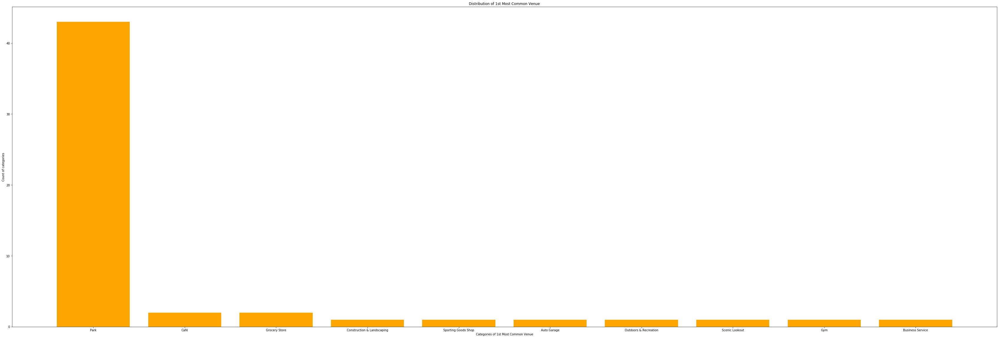

In [69]:
x=cluster_1['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_1['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (60,20))
plt.bar(x,y,color='orange')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')

# Cluster 2

In [56]:
cluster_2=sydney_merged.loc[sydney_merged['Labels'] == 1]

In [57]:
cluster_2

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
0,Abbotsbury,2176,-33.872850,150.867210,Convenience Store,1.0
3,Airds,2560,-34.084470,150.829040,Pub,1.0
5,Alfords Point,2234,-33.993480,151.024710,Candy Store,1.0
7,Allawah,2218,-33.970260,151.116000,Pub,1.0
8,Ambarvale,2560,-34.083870,150.802430,Pub,1.0
12,Arcadia,2159,-33.882522,151.004487,Dessert Shop,1.0
13,Arncliffe,2205,-33.936650,151.146790,Thai Restaurant,1.0
16,Ashbury,2193,-33.898170,151.121000,Scenic Lookout,1.0
18,Ashfield,2131,-33.889200,151.125430,Platform,1.0
19,Asquith,2077,-33.688710,151.109470,Hobby Shop,1.0


In [58]:
print(cluster_2.shape)

(343, 6)


In [59]:
cluster_2['1st Most Common Venue'].value_counts()

Fast Food Restaurant             25
Café                             19
Convenience Store                16
Pub                              15
Platform                         12
Coffee Shop                      11
Grocery Store                    10
Thai Restaurant                  10
Supermarket                      10
Pizza Place                      10
Bakery                           10
Shopping Mall                     8
Liquor Store                      8
Playground                        7
Indian Restaurant                 6
Golf Course                       6
Gym                               6
Business Service                  6
Chinese Restaurant                6
Lebanese Restaurant               5
Electronics Store                 5
Italian Restaurant                4
Park                              4
Bar                               3
Boat or Ferry                     3
Construction & Landscaping        3
Furniture / Home Store            3
Japanese Restaurant         

#### As it is clearly seen that in cluster 2 total number of suburbs are 211 which is 30% of the total suburbs of Sydney and in these suburbs only 174 suburbs are those suburbs where cafe or coffe shop is the most visited venue which is  82% of cluster 2.

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

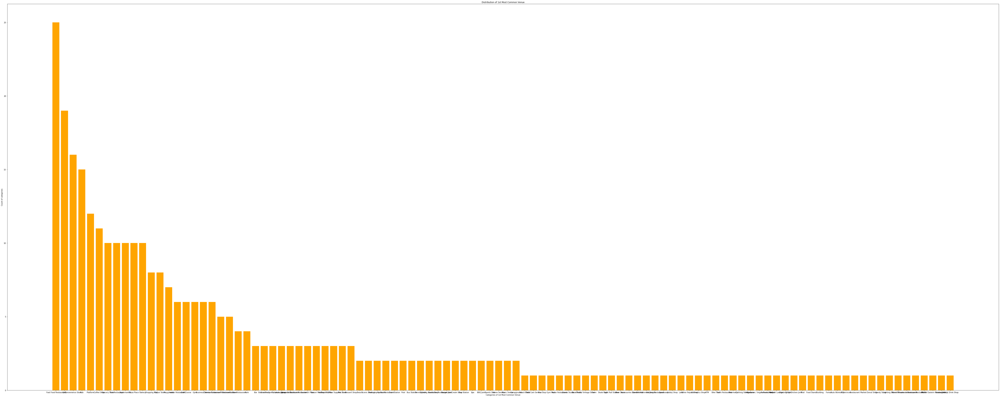

In [70]:
x=cluster_2['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_2['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (100,40))
plt.bar(x,y,color='orange')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')

# Cluster 3

In [61]:
cluster_3=sydney_merged.loc[sydney_merged['Labels'] == 2]

In [62]:
cluster_3

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
1,Abbotsford,2046,-33.850410,151.128460,Café,2.0
4,Alexandria,2015,-33.912370,151.197030,Café,2.0
6,Allambie Heights,2100,-33.765610,151.251590,Café,2.0
9,Annandale,2038,-33.880050,151.171300,Café,2.0
15,Artarmon,2064,-33.808140,151.183800,Café,2.0
21,Audley,2232,-33.897596,151.154571,Café,2.0
23,Avalon,2107,-33.635860,151.328080,Café,2.0
24,Avalon Beach,2107,-33.635860,151.328080,Café,2.0
27,Balgowlah,2093,-33.793820,151.260660,Liquor Store,2.0
29,Balmain,2041,-33.856000,151.175870,Café,2.0


In [63]:
print(cluster_3.shape)

(227, 6)


In [64]:
cluster_3['1st Most Common Venue'].value_counts()

Café                           176
Grocery Store                    7
Convenience Store                6
Bakery                           6
Pub                              3
Liquor Store                     2
Japanese Restaurant              2
Gym                              2
Indian Restaurant                2
Bar                              2
Garden Center                    1
Scenic Lookout                   1
Paintball Field                  1
Eastern European Restaurant      1
Print Shop                       1
Golf Course                      1
Burger Joint                     1
Cosmetics Shop                   1
Fried Chicken Joint              1
Athletics & Sports               1
Beach                            1
Gas Station                      1
Vietnamese Restaurant            1
Pizza Place                      1
Home Service                     1
Supermarket                      1
Italian Restaurant               1
Korean Restaurant                1
Monument / Landmark 

#### As it is clearly seen that in cluster 3 total number of suburbs are 65 which is 7.4% of the total suburbs of Sydney and in these suburbs only 3 suburbs are those suburbs where cafe or coffe shop is the most visited venue which is 4.6% of cluster 3

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

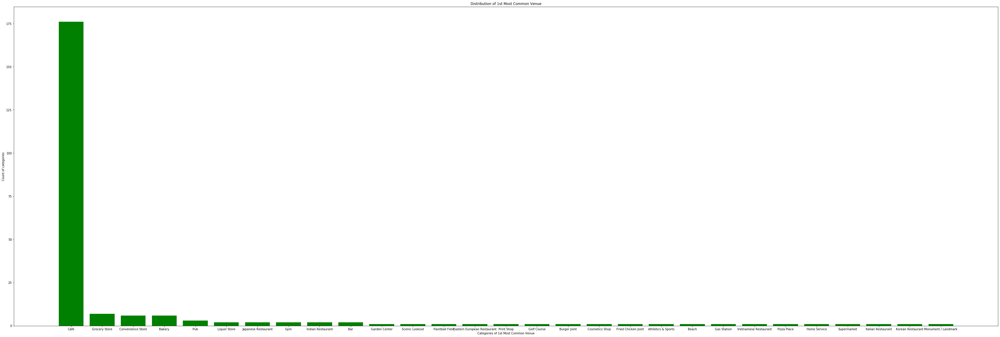

In [73]:
x=cluster_3['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_3['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (60,20))
plt.bar(x,y,color='Green')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')